In [1]:
# import libraries random and matplotlib.
import random
import matplotlib.pyplot as plt

In [2]:
# define the function random_response() that takes a population size n and a number of drug users d, returns a list of size n with d True values and n - d False values. 
def report_druguse_state0(n,d):
    # create the list druguse_results, to print the results of drug use in the population. 
    druguse_results = []
    # create variable rest, to save the number of non-drug users.
    rest = n - d
    # use while loop: for each drug user, print 'True', and for each non-drug user, print 'False'.
    while(d > 0):
        druguse_results.append(True)
        d = d - 1
    while(rest > 0):
        druguse_results.append(False)
        rest = rest - 1
    return druguse_results

In [3]:
# testing code:
report_druguse_state0(15,5)

[True,
 True,
 True,
 True,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False]

In [4]:
# define the function report_druguse_states1(), which could return samples' responses to the randomized response protocol from the slides.
def report_druguse_states1(n,d,s):
    # create list pop_result to save the results of drug use in the population.
    # create list flip_choice1, flip_choice2 to list the possible results of flip coins for two times.
    # create list flip_result1, final_result to save the results after the first coin flip, and the samples' reponses.
    pop_result = []
    flip_choice1 = ['Head','Tail']
    flip_choice2 = ['True', 'False']
    flip_result1 = []
    final_result = []
    # use two for loop to save the results of drug use in the population into pop_result.
    for i in range(0,d):
        pop_result.append('Drug')
    for i in range(0,n-d):
        pop_result.append('Non-Drug')
    # use random.sample to select a sample of size s from such population, save into sample_result
    sample_result = random.sample(pop_result,s)
    # use for loop to save the result of first coin flip into flip_result1.
    for i in range(0,s):
        flip_result1.append(random.choice(flip_choice1))
    # use zip function to store sample_result and flip_result1 in a list samp_and_flip_result1 in order.
    samp_and_flip_result1 = list(zip(sample_result,flip_result1))

    # traverse each element in the list samp_and_flip_result1, 
    # if the result of first coin flip is 'Head', flip a coin again as the sample's response;
    # if the result of first coin flip is 'Tail' and the sampled person is a druguser, 'True' is the sample's response, otherwise 'False' is the response.
    for j in range(0,s):
        if 'Head' in samp_and_flip_result1[j]:
            final_result.append(random.choice(flip_choice2))
        elif 'Tail' in samp_and_flip_result1[j]:
            if 'Drug' in samp_and_flip_result1[j]:
                final_result.append('True')
            elif 'Non-Drug' in samp_and_flip_result1[j]:
                final_result.append('False')
        else: break
    
    # use for loop to print the result of samples' reponses.
    for k in range(0,s):
        print({final_result[k]})

In [5]:
# testing code:
report_druguse_states1(50,9,30)

{'True'}
{'True'}
{'False'}
{'True'}
{'False'}
{'False'}
{'False'}
{'True'}
{'False'}
{'True'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'False'}
{'True'}
{'False'}
{'True'}
{'True'}
{'False'}
{'False'}
{'False'}
{'False'}


In [6]:
# define the function report_druguse_states2(), which could return the estimated number of drug users in the population that would be predicted using such a sample and the randomized response protocol. 
def report_druguse_states2(n,d,s):
    pop_result = []
    flip_choice1 = ['Head','Tail']
    flip_choice2 = ['True', 'False']
    flip_result1 = []
    final_result = []
    yes = 0
    for i in range(0,d):
        pop_result.append('Drug')
    for i in range(0,n-d):
        pop_result.append('Non-Drug')
    sample_result = random.sample(pop_result,s)
    for i in range(0,s):
        flip_result1.append(random.choice(flip_choice1))
    samp_and_flip_result1 = list(zip(sample_result,flip_result1))
    for j in range(0,s):
        if 'Head' in samp_and_flip_result1[j]:
            final_result.append(random.choice(flip_choice2))
        elif 'Tail' in samp_and_flip_result1[j]:
            if 'Drug' in samp_and_flip_result1[j]:
                final_result.append('True')
            elif 'Non-Drug' in samp_and_flip_result1[j]:
                final_result.append('False')
        else: break
    final_integrate_result = list(zip(sample_result,final_result))
    
    # above is same as report_druguse_states1()
    # use for loop to calculate the number of sampled people that reported 'True', save in the variable yes.
    for k in range(0,s):
        if 'True' in final_integrate_result[k]:
            yes = yes + 1
    #calculate the measured yes rate and the fraction of drug users in the population p.
    measured_yes_rate = yes/s
    p = (measured_yes_rate - 0.25)/0.5
    global estimated_druguser_in_pop 
    # calculate the estimated number of drug users in the population that could be predicted using such a sample
    estimated_druguser_in_pop = p * n
    print(f"the measured yes rate is {measured_yes_rate:.2f}, the fraction of drugusers p is {p:.2f}, and the estimated number of drug users in the population that would be predicted using such a sample is {estimated_druguser_in_pop:.0f}.")

In [7]:
# testing code:
report_druguse_states2(50,9,30) 

the measured yes rate is 0.17, the fraction of drugusers p is -0.17, and the estimated number of drug users in the population that would be predicted using such a sample is -8.


In [8]:
report_druguse_states2(1000,100,50)

the measured yes rate is 0.38, the fraction of drugusers p is 0.26, and the estimated number of drug users in the population that would be predicted using such a sample is 260.


In [9]:
# define the function repeat_function() to repeat the experiment many times.
def repeat_function(times,report_druguse_states2,n,d,s):
    # set estimated_druguser_in_pop, estimated_druguser as global variables.
    global estimated_druguser_in_pop
    global estimated_druguser
    # create list estimated_druguser to save all the results of estimated number of drug users.
    estimated_druguser = []
    for i in range(0,times):
        report_druguse_states2(n,d,s)
        estimated_druguser.append(estimated_druguser_in_pop)

the measured yes rate is 0.32, the fraction of drugusers p is 0.14, and the estimated number of drug users in the population that would be predicted using such a sample is 140.
the measured yes rate is 0.34, the fraction of drugusers p is 0.18, and the estimated number of drug users in the population that would be predicted using such a sample is 180.
the measured yes rate is 0.28, the fraction of drugusers p is 0.06, and the estimated number of drug users in the population that would be predicted using such a sample is 60.
the measured yes rate is 0.30, the fraction of drugusers p is 0.10, and the estimated number of drug users in the population that would be predicted using such a sample is 100.
the measured yes rate is 0.26, the fraction of drugusers p is 0.02, and the estimated number of drug users in the population that would be predicted using such a sample is 20.
the measured yes rate is 0.28, the fraction of drugusers p is 0.06, and the estimated number of drug users in the pop

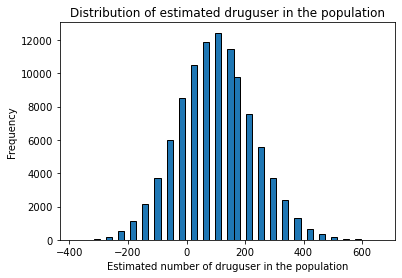

In [10]:
repeat_function(100000,report_druguse_states2,1000,100,50)

# use matplotlib.hist to draw the histagram of numbers of estimated drug users.
plt.hist(estimated_druguser, bins = 50, edgecolor = "black")
plt.xlabel("Estimated number of druguser in the population")
plt.ylabel("Frequency")
plt.title("Distribution of estimated druguser in the population")
plt.show()

In [11]:
repeat_function(100000,report_druguse_states2,100000,10000,5000)

plt.hist(estimated_druguser, bins = 50, edgecolor = "black")
plt.xlabel("Estimated number of druguser in the population")
plt.ylabel("Frequency")
plt.title("Distribution of estimated druguser in the population")
plt.show()

the measured yes rate is 0.30, the fraction of drugusers p is 0.10, and the estimated number of drug users in the population that would be predicted using such a sample is 10320.
the measured yes rate is 0.30, the fraction of drugusers p is 0.10, and the estimated number of drug users in the population that would be predicted using such a sample is 10080.
the measured yes rate is 0.30, the fraction of drugusers p is 0.10, and the estimated number of drug users in the population that would be predicted using such a sample is 9520.
the measured yes rate is 0.29, the fraction of drugusers p is 0.09, and the estimated number of drug users in the population that would be predicted using such a sample is 8560.
the measured yes rate is 0.29, the fraction of drugusers p is 0.08, and the estimated number of drug users in the population that would be predicted using such a sample is 8240.
the measured yes rate is 0.30, the fraction of drugusers p is 0.10, and the estimated number of drug users i

the measured yes rate is 0.46, the fraction of drugusers p is 0.42, and the estimated number of drug users in the population that would be predicted using such a sample is 420.
the measured yes rate is 0.44, the fraction of drugusers p is 0.38, and the estimated number of drug users in the population that would be predicted using such a sample is 380.
the measured yes rate is 0.42, the fraction of drugusers p is 0.34, and the estimated number of drug users in the population that would be predicted using such a sample is 340.
the measured yes rate is 0.42, the fraction of drugusers p is 0.34, and the estimated number of drug users in the population that would be predicted using such a sample is 340.
the measured yes rate is 0.48, the fraction of drugusers p is 0.46, and the estimated number of drug users in the population that would be predicted using such a sample is 460.
the measured yes rate is 0.54, the fraction of drugusers p is 0.58, and the estimated number of drug users in the p

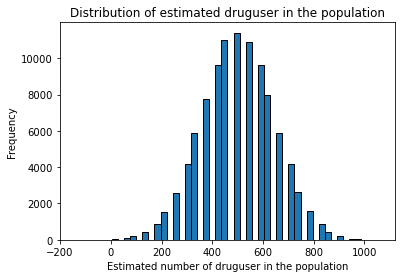

In [ ]:
repeat_function(100000,report_druguse_states2,1000,500,50)

plt.hist(estimated_druguser, bins = 50, edgecolor = "black")
plt.xlabel("Estimated number of druguser in the population")
plt.ylabel("Frequency")
plt.title("Distribution of estimated druguser in the population")
plt.show()